<a href="https://colab.research.google.com/github/Jalam1001/huggingface/blob/main/Fine_tuned_Model_paligemma_Inference.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Fine-tuned PaliGemma Inference

In this notebook we will see how to infer a PaliGemma fine-tuned model (using 🤗 transformers).

We need the latest version of transformers library.

In [6]:
!pip install -q -U transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.1/9.1 MB 24.4 MB/s eta 0:00:00


Let's login to Hugging Face.

In [7]:
from huggingface_hub import notebook_login
notebook_login()

Let's load the model.

In [8]:
from transformers import AutoProcessor, PaliGemmaForConditionalGeneration

model_id = "merve/paligemma_vqav2"
model = PaliGemmaForConditionalGeneration.from_pretrained(model_id)
processor = AutoProcessor.from_pretrained("google/paligemma-3b-pt-224")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:81: UserWarning: 
Access to the secret `HF_TOKEN` has not been granted on this notebook.
You will not be requested again.
Please restart the session if you want to be prompted again.
  warnings.warn(


config.json:   0%|          | 0.00/1.02k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/62.6k [00:00<?, ?B/s]

model-00001-of-00002.safetensors:   0%|          | 0.00/4.99G [00:00<?, ?B/s]

model-00002-of-00002.safetensors:   0%|          | 0.00/862M [00:00<?, ?B/s]

`config.hidden_act` is ignored, you should use `config.hidden_activation` instead.
Gemma's activation function will be set to `gelu_pytorch_tanh`. Please, use
`config.hidden_activation` if you want to override this behaviour.
See https://github.com/huggingface/transformers/pull/29402 for more details.


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/137 [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/699 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

tokenizer.model:   0%|          | 0.00/4.26M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/17.5M [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/24.0 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/607 [00:00<?, ?B/s]

We have fine-tuned the model on visual question answering (VQAv2). Hence, we will pass an image to the model and ask a question about it. Below is a rather challenging image for vision language models. Pretrained PaliGemma responds below image and question with "antique".

In [ ]:
from PIL import Image
import requests


prompt = "What is behind the cat?"
image_file = "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/cat.png?download=true"
raw_image = Image.open(requests.get(image_file, stream=True).raw)

![](https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/cat.png?download=true)

In [ ]:
inputs = processor(prompt, raw_image.convert("RGB"), return_tensors="pt")
output = model.generate(**inputs, max_new_tokens=20)

print(processor.decode(output[0], skip_special_tokens=True)[len(prompt):])


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]


gramophone


Image size: (5070, 3912)
Image format: JPEG
Image mode: RGB


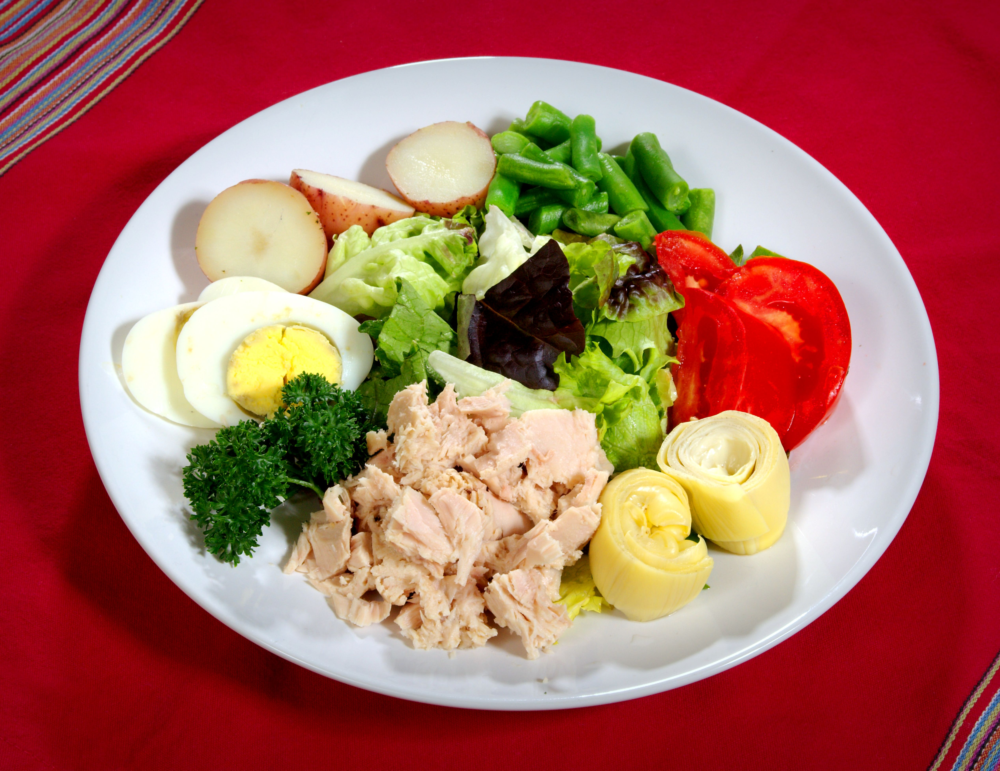

In [5]:
from PIL import Image

# Load the image
raw_image = Image.open('./food_plate.jpg')

# Print the image details
print(f"Image size: {raw_image.size}")
print(f"Image format: {raw_image.format}")
print(f"Image mode: {raw_image.mode}")

# Display the image
raw_image

In [10]:
prompt = "what is in image?"

inputs = processor(prompt, raw_image.convert("RGB"), return_tensors="pt")
output = model.generate(**inputs, max_new_tokens=500)

print(processor.decode(output[0], skip_special_tokens=True)[len(prompt):])


salad


In [11]:
prompt = "what is in salad?"

inputs = processor(prompt, raw_image.convert("RGB"), return_tensors="pt")
output = model.generate(**inputs, max_new_tokens=500)

print(processor.decode(output[0], skip_special_tokens=True)[len(prompt):])


tuna


In [12]:
prompt = "list each food item in the salad?"

inputs = processor(prompt, raw_image.convert("RGB"), return_tensors="pt")
output = model.generate(**inputs, max_new_tokens=500)

print(processor.decode(output[0], skip_special_tokens=True)[len(prompt):])


artichoke, lettuce, tomato, potato, egg, tuna, parsley
